In [9]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/a-fine-windy-day-hackerearth-ml-challenge/train_data.csv
/kaggle/input/a-fine-windy-day-hackerearth-ml-challenge/test_data.csv


In [10]:
df = pd.read_csv('../input/a-fine-windy-day-hackerearth-ml-challenge/train_data.csv')
df_test = pd.read_csv('../input/a-fine-windy-day-hackerearth-ml-challenge/test_data.csv')

In [11]:
df.head()

,tracking_id,datetime,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),...,windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),turbine_status,cloud_level,blade_length(m),blade_breadth(m),windmill_height(m),windmill_generated_power(kW/h)
0,WM_33725,2019-08-04 14:33:20,94.820023,-99.000000,41.723019,-0.903423,82.410573,42.523015,2563.124522,76.665560,...,NaN,239.836388,2730.310605,42.084666,BA,Medium,2.217542,0.314065,24.281689,6.766521
1,WM_698,2018-11-05 10:13:20,241.832734,27.764785,-99.000000,-99.000000,44.104919,46.258870,2372.384119,78.129803,...,NaN,337.944723,1780.207200,107.888643,A2,Medium,4.210346,0.448494,27.262139,5.966275
2,WM_39146,2019-09-14 14:03:20,95.484724,NaN,41.855473,12.652763,42.322098,42.878552,1657.169646,67.654469,...,45.033197,227.850294,1666.049900,-42.931459,ABC,Medium,2.719475,0.302321,27.366127,2.874342
3,WM_6757,2018-12-25 15:33:20,238.819424,-99.000000,45.443914,15.115323,44.759643,47.282101,2888.134079,95.389974,...,44.827154,492.081520,1964.502895,42.744596,ABC,NaN,4.857385,0.367140,24.287767,14.851089
4,WM_21521,2019-05-04 03:13:20,10.722890,NaN,41.981183,1.715696,-17.616459,43.469852,781.695419,37.423065,...,-99.000000,259.274601,1177.516152,13.387289,AAA,Medium,NaN,0.453374,27.971650,3.519074


In [12]:
df_test.head()

,tracking_id,datetime,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),...,area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),turbine_status,cloud_level,blade_length(m),blade_breadth(m),windmill_height(m)
0,WM_19817,2019-04-17 08:53:20,94.324266,17.641186,89.714193,51.146788,40.460560,39.594734,1073.202715,66.830037,...,24.004812,43.756693,445.976992,1664.222023,21.912243,BA,Medium,3.185837,0.403965,25.572431
1,WM_18723,2019-03-30 07:43:20,10.088870,13.978119,43.272846,46.516394,40.027788,41.176860,517.436430,37.284163,...,29.431813,42.728174,499.595287,1165.111992,-35.050093,A,Medium,3.016603,0.444755,24.371823
2,WM_34552,2019-08-10 11:33:20,347.152090,31.423035,41.076640,26.931602,43.109122,43.439556,1480.716492,70.010762,...,29.924235,43.256122,245.432231,1667.720491,27.195302,B2,Medium,2.611941,0.387368,27.654677
3,WM_28570,2019-06-26 03:53:20,24.471997,-99.000000,14.375078,66.513953,13.741253,15.577472,887.979475,41.445258,...,23.886434,13.501595,NaN,1329.744740,15.245757,BBB,Low,2.866805,0.450478,24.189426
4,WM_36934,2019-08-27 16:43:20,96.997026,33.281836,41.405192,1.843112,121.572907,43.934587,2053.916354,68.007787,...,35.906889,-99.000000,442.425744,691.408996,34.257024,A,Low,3.549672,0.368355,4.885440


In [13]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import pandas_profiling as pp
import seaborn as sns
import warnings
import os

warnings.filterwarnings('ignore')
%matplotlib inline

In [14]:
pp.ProfileReport(df)

Summarize dataset:   0%|          | 0/35 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [15]:
!pip install pycaret

     |████████████████████████████████| 261 kB 907 kB/s eta 0:00:01
     |████████████████████████████████| 24.2 MB 357 kB/s  eta 0:00:01  |                                | 51 kB 3.2 MB/s eta 0:00:08     |▊                               | 583 kB 3.5 MB/s eta 0:00:07     |█▎                              | 972 kB 3.5 MB/s eta 0:00:07
     |████████████████████████████████| 6.8 MB 31.2 MB/s eta 0:00:01
     |████████████████████████████████| 167 kB 39.2 MB/s eta 0:00:01
     |████████████████████████████████| 14.2 MB 35.7 MB/s eta 0:00:01
     |████████████████████████████████| 102 kB 59.0 MB/s eta 0:00:01
     |████████████████████████████████| 54 kB 2.1 MB/s  eta 0:00:01
     |████████████████████████████████| 1.1 MB 58.2 MB/s eta 0:00:01
     |████████████████████████████████| 79 kB 5.8 MB/s  eta 0:00:01
     |████████████████████████████████| 1.7 MB 63.3 MB/s eta 0:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend depen

In [16]:
from pycaret.regression import *

In [17]:
df.dtypes

tracking_id                        object
datetime                           object
wind_speed(m/s)                   float64
atmospheric_temperature(°C)       float64
shaft_temperature(°C)             float64
blades_angle(°)                   float64
gearbox_temperature(°C)           float64
engine_temperature(°C)            float64
motor_torque(N-m)                 float64
generator_temperature(°C)         float64
atmospheric_pressure(Pascal)      float64
area_temperature(°C)              float64
windmill_body_temperature(°C)     float64
wind_direction(°)                 float64
resistance(ohm)                   float64
rotor_torque(N-m)                 float64
turbine_status                     object
cloud_level                        object
blade_length(m)                   float64
blade_breadth(m)                  float64
windmill_height(m)                float64
windmill_generated_power(kW/h)    float64
dtype: object

In [18]:
df.columns

Index(['tracking_id', 'datetime', 'wind_speed(m/s)',
       'atmospheric_temperature(°C)', 'shaft_temperature(°C)',
       'blades_angle(°)', 'gearbox_temperature(°C)', 'engine_temperature(°C)',
       'motor_torque(N-m)', 'generator_temperature(°C)',
       'atmospheric_pressure(Pascal)', 'area_temperature(°C)',
       'windmill_body_temperature(°C)', 'wind_direction(°)', 'resistance(ohm)',
       'rotor_torque(N-m)', 'turbine_status', 'cloud_level', 'blade_length(m)',
       'blade_breadth(m)', 'windmill_height(m)',
       'windmill_generated_power(kW/h)'],
      dtype='object')

In [19]:
df.isnull().mean()

tracking_id                       0.000000
datetime                          0.000000
wind_speed(m/s)                   0.009681
atmospheric_temperature(°C)       0.122340
shaft_temperature(°C)             0.000071
blades_angle(°)                   0.007660
gearbox_temperature(°C)           0.000035
engine_temperature(°C)            0.000426
motor_torque(N-m)                 0.000851
generator_temperature(°C)         0.000426
atmospheric_pressure(Pascal)      0.095993
area_temperature(°C)              0.000000
windmill_body_temperature(°C)     0.083794
wind_direction(°)                 0.180957
resistance(ohm)                   0.000035
rotor_torque(N-m)                 0.020284
turbine_status                    0.062376
cloud_level                       0.009787
blade_length(m)                   0.180603
blade_breadth(m)                  0.000000
windmill_height(m)                0.019255
windmill_generated_power(kW/h)    0.007340
dtype: float64

In [20]:
reg = setup(data = df, 
             target = 'windmill_generated_power(kW/h)',
             numeric_imputation = 'mean',
             categorical_features = ['turbine_status','cloud_level',]  , 
             ignore_features = ['tracking_id','datetime'],
             normalize = True,
             silent = True)

,Description,Value
0,session_id,3385
1,Target,windmill_generated_power(kW/h)
2,Original Data,"(28200, 22)"
3,Missing Values,True
4,Numeric Features,17
5,Categorical Features,2
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(19605, 36)"


In [21]:
compare_models()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
catboost,CatBoost Regressor,0.3172,0.2715,0.5191,0.9626,0.0738,0.0598,7.3230
rf,Random Forest Regressor,0.3008,0.2803,0.5264,0.9614,0.0727,0.0557,13.1890
lightgbm,Light Gradient Boosting Machine,0.3303,0.2854,0.5321,0.9606,0.0765,0.0625,0.3640
xgboost,Extreme Gradient Boosting,0.3287,0.2914,0.5375,0.9598,0.0757,0.0612,32.4060
et,Extra Trees Regressor,0.3737,0.3473,0.5878,0.9521,0.0808,0.0682,5.7550
gbr,Gradient Boosting Regressor,0.4021,0.3838,0.6177,0.9471,0.0912,0.0782,4.6410
dt,Decision Tree Regressor,0.4193,0.5652,0.7505,0.9218,0.1005,0.0766,0.2580
ada,AdaBoost Regressor,1.0831,1.8980,1.3774,0.7373,0.2451,0.2722,1.5580
knn,K Neighbors Regressor,1.2655,2.8231,1.6796,0.6100,0.2405,0.2471,1.7500
br,Bayesian Ridge,1.5791,4.1555,2.0378,0.4258,0.2890,0.3045,0.0440


In [22]:
cb = create_model('catboost')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.3364,0.3124,0.5589,0.9564,0.0776,0.0616
1,0.3359,0.3723,0.6101,0.9523,0.0807,0.0631
2,0.3042,0.2257,0.4751,0.9683,0.0662,0.0564
3,0.3166,0.3281,0.5728,0.9546,0.0773,0.0591
4,0.3151,0.2393,0.4892,0.9668,0.0750,0.0605
5,0.3116,0.2326,0.4823,0.9652,0.0752,0.0611
6,0.3113,0.2797,0.5288,0.9614,0.0715,0.0586
7,0.3142,0.2601,0.5100,0.9639,0.0729,0.0593
8,0.3058,0.2219,0.4710,0.9694,0.0667,0.0566
9,0.3212,0.2427,0.4927,0.9674,0.0748,0.0616


In [23]:
#by using randam forest regression
rf = create_model('rf')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.3160,0.3245,0.5697,0.9547,0.0780,0.0573
1,0.3292,0.3926,0.6266,0.9497,0.0843,0.0620
2,0.2850,0.2081,0.4562,0.9708,0.0634,0.0530
3,0.3014,0.3715,0.6095,0.9486,0.0751,0.0544
4,0.2877,0.2179,0.4668,0.9697,0.0706,0.0543
5,0.2949,0.2438,0.4937,0.9635,0.0760,0.0566
6,0.2983,0.3051,0.5523,0.9579,0.0708,0.0544
7,0.3009,0.2585,0.5084,0.9641,0.0706,0.0554
8,0.2932,0.2335,0.4832,0.9678,0.0668,0.0533
9,0.3012,0.2473,0.4973,0.9668,0.0715,0.0561


In [ ]:
#tuned_cb = tune_model(cb)

In [25]:
print(cb)

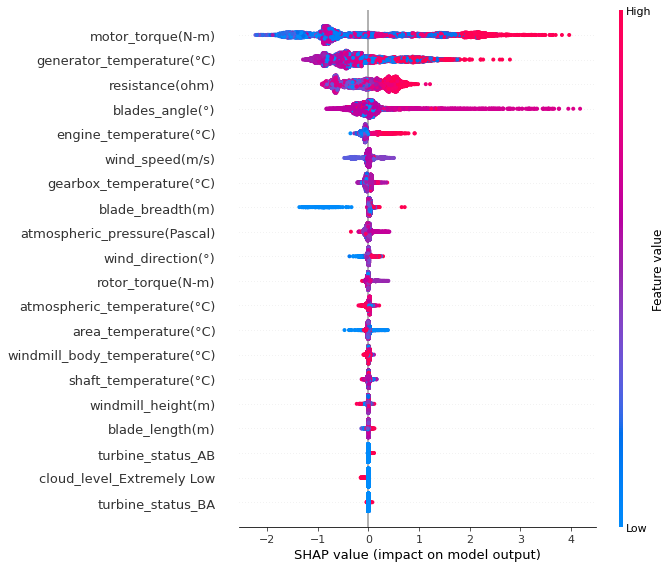

In [27]:
interpret_model(cb)

In [28]:
predictions = predict_model(cb, data = df_test)

In [29]:
predictions_rf = predict_model(rf, data = df_test)

In [30]:
predictions[:5]

,tracking_id,datetime,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),...,windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),turbine_status,cloud_level,blade_length(m),blade_breadth(m),windmill_height(m),Label
0,WM_19817,2019-04-17 08:53:20,94.324266,17.641186,89.714193,51.146788,40.460560,39.594734,1073.202715,66.830037,...,43.756693,445.976992,1664.222023,21.912243,BA,Medium,3.185837,0.403965,25.572431,2.467795
1,WM_18723,2019-03-30 07:43:20,10.088870,13.978119,43.272846,46.516394,40.027788,41.176860,517.436430,37.284163,...,42.728174,499.595287,1165.111992,-35.050093,A,Medium,3.016603,0.444755,24.371823,2.306662
2,WM_34552,2019-08-10 11:33:20,347.152090,31.423035,41.076640,26.931602,43.109122,43.439556,1480.716492,70.010762,...,43.256122,245.432231,1667.720491,27.195302,B2,Medium,2.611941,0.387368,27.654677,3.341995
3,WM_28570,2019-06-26 03:53:20,24.471997,-99.000000,14.375078,66.513953,13.741253,15.577472,887.979475,41.445258,...,13.501595,NaN,1329.744740,15.245757,BBB,Low,2.866805,0.450478,24.189426,7.318789
4,WM_36934,2019-08-27 16:43:20,96.997026,33.281836,41.405192,1.843112,121.572907,43.934587,2053.916354,68.007787,...,-99.000000,442.425744,691.408996,34.257024,A,Low,3.549672,0.368355,4.885440,3.767968


In [31]:
predictions_rf[:5]

,tracking_id,datetime,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),...,windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),turbine_status,cloud_level,blade_length(m),blade_breadth(m),windmill_height(m),Label
0,WM_19817,2019-04-17 08:53:20,94.324266,17.641186,89.714193,51.146788,40.460560,39.594734,1073.202715,66.830037,...,43.756693,445.976992,1664.222023,21.912243,BA,Medium,3.185837,0.403965,25.572431,2.870855
1,WM_18723,2019-03-30 07:43:20,10.088870,13.978119,43.272846,46.516394,40.027788,41.176860,517.436430,37.284163,...,42.728174,499.595287,1165.111992,-35.050093,A,Medium,3.016603,0.444755,24.371823,2.479581
2,WM_34552,2019-08-10 11:33:20,347.152090,31.423035,41.076640,26.931602,43.109122,43.439556,1480.716492,70.010762,...,43.256122,245.432231,1667.720491,27.195302,B2,Medium,2.611941,0.387368,27.654677,3.468592
3,WM_28570,2019-06-26 03:53:20,24.471997,-99.000000,14.375078,66.513953,13.741253,15.577472,887.979475,41.445258,...,13.501595,NaN,1329.744740,15.245757,BBB,Low,2.866805,0.450478,24.189426,6.694495
4,WM_36934,2019-08-27 16:43:20,96.997026,33.281836,41.405192,1.843112,121.572907,43.934587,2053.916354,68.007787,...,-99.000000,442.425744,691.408996,34.257024,A,Low,3.549672,0.368355,4.885440,3.466533


In [32]:
df_sub = df_test[['tracking_id','datetime']]# for catboost

In [33]:
df_sub_rf = df_test[['tracking_id','datetime']]# for randomforest

In [34]:
df_sub[:5] # for catboost

,tracking_id,datetime
0,WM_19817,2019-04-17 08:53:20
1,WM_18723,2019-03-30 07:43:20
2,WM_34552,2019-08-10 11:33:20
3,WM_28570,2019-06-26 03:53:20
4,WM_36934,2019-08-27 16:43:20


In [35]:
df_sub['windmill_generated_power(kW/h)'] = predictions['Label'] #for catboost 

In [36]:
df_sub_rf['windmill_generated_power(kW/h)'] = predictions_rf['Label'] #for rf

In [37]:
df_sub[:5]# for catboost

,tracking_id,datetime,windmill_generated_power(kW/h)
0,WM_19817,2019-04-17 08:53:20,2.467795
1,WM_18723,2019-03-30 07:43:20,2.306662
2,WM_34552,2019-08-10 11:33:20,3.341995
3,WM_28570,2019-06-26 03:53:20,7.318789
4,WM_36934,2019-08-27 16:43:20,3.767968


In [38]:
df_sub_rf[:5]# for rf

,tracking_id,datetime,windmill_generated_power(kW/h)
0,WM_19817,2019-04-17 08:53:20,2.870855
1,WM_18723,2019-03-30 07:43:20,2.479581
2,WM_34552,2019-08-10 11:33:20,3.468592
3,WM_28570,2019-06-26 03:53:20,6.694495
4,WM_36934,2019-08-27 16:43:20,3.466533


In [39]:
df_sub.to_csv('./sub.csv',header=True,index=False) #for catboost
df_sub

,tracking_id,datetime,windmill_generated_power(kW/h)
0,WM_19817,2019-04-17 08:53:20,2.467795
1,WM_18723,2019-03-30 07:43:20,2.306662
2,WM_34552,2019-08-10 11:33:20,3.341995
3,WM_28570,2019-06-26 03:53:20,7.318789
4,WM_36934,2019-08-27 16:43:20,3.767968
...,...,...,...
12081,WM_13376,2019-02-12 11:33:20,6.732609
12082,WM_1630,2018-11-12 17:33:20,3.337281
12083,WM_24703,2019-05-27 11:53:20,5.325920
12084,WM_22893,2019-05-13 21:53:20,5.355182


In [40]:
df_sub_rf.to_csv('./sub.csv',header=True,index=False) #for catboost
df_sub_rf

,tracking_id,datetime,windmill_generated_power(kW/h)
0,WM_19817,2019-04-17 08:53:20,2.870855
1,WM_18723,2019-03-30 07:43:20,2.479581
2,WM_34552,2019-08-10 11:33:20,3.468592
3,WM_28570,2019-06-26 03:53:20,6.694495
4,WM_36934,2019-08-27 16:43:20,3.466533
...,...,...,...
12081,WM_13376,2019-02-12 11:33:20,6.701257
12082,WM_1630,2018-11-12 17:33:20,3.334079
12083,WM_24703,2019-05-27 11:53:20,5.320864
12084,WM_22893,2019-05-13 21:53:20,5.460813


In [41]:
from IPython.display import HTML
import pandas as pd
import numpy as np
import base64

# function that takes in a dataframe and creates a text link to  

def create_download_link(df, title = "Download CSV file", filename = "Submission.csv"):  
    csv = df.to_csv()
    b64 = base64.b64encode(csv.encode())
    payload = b64.decode()
    html = '<a download="{filename}" href="data:text/csv;base64,{payload}" target="_blank">{title}</a>'
    html = html.format(payload=payload,title=title,filename=filename)
    return HTML(html)

create_download_link(df_sub)#for catboost

In [42]:
create_download_link(df_sub_rf) #for rf